In [2]:
import os
# os.environ['PATH'].split(';')
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns
plt.style.use('seaborn-white')
import pandas as pd
import re
import cv2

import skimage.io
from skimage import color

from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report, confusion_matrix

%matplotlib inline

### Dados para treinamento dos modelos

In [3]:
df_treino = pd.DataFrame(columns=['name','data','classe'])
i = 0
for filename in os.listdir("dataset/treino"):
    path = os.path.join('dataset','treino', filename)
    img = skimage.io.imread(path)
    classe = re.search('floresta|incendio', filename)[0]
    if classe == 'floresta':
        classe = 1
    else:
        classe = 2
    df_treino.loc[i]=[filename,np.ravel(color.rgb2gray(img)),classe]
    i = i+1
df_treino

,name,data,classe
0,floresta7.jpg,"[0.11970156862745097, 0.17852509803921568, 0.1...",1
1,floresta50.jpg,"[0.6894541176470589, 0.41128352941176477, 0.44...",1
2,incendio44.jpg,"[0.15014, 0.15014, 0.15014, 0.1498572549019607...",2
3,floresta40.jpg,"[0.11369647058823529, 0.08486941176470587, 0.1...",1
4,floresta43.jpg,"[0.991256862745098, 0.991256862745098, 0.99125...",1
...,...,...,...
95,incendio30.jpg,"[0.8140423529411766, 0.8140423529411766, 0.814...",2
96,incendio14.jpg,"[0.7153090196078431, 0.746681568627451, 0.7155...",2
97,incendio18.jpg,"[0.8591290196078432, 0.8596945098039216, 0.859...",2
98,floresta21.jpg,"[0.02538078431372549, 0.06938901960784315, 0.0...",1


In [4]:
df1 = df_treino[df_treino['classe'] == 1]
df2 = df_treino[df_treino['classe'] == 2]
df1 = df1.reset_index(drop=True)
df2 = df2.reset_index(drop=True)

## Dados para teste/validação dos modelos

In [5]:
df_teste = pd.DataFrame(columns=['name','data','classe_real','classe_predita'])
i = 0
for filename in os.listdir("dataset/teste"):
    path = os.path.join('dataset','teste', filename)
    img = skimage.io.imread(path)
    classe = re.search('floresta|incendio', filename)[0]
    if classe == 'floresta':
        classe = 1
    else:
        classe = 2
    df_teste.loc[i]=[filename,np.ravel(color.rgb2gray(img)),classe,0]
    i = i+1
df_teste

,name,data,classe_real,classe_predita
0,floresta49.jpg,"[0.25238392156862743, 0.43417568627450975, 0.3...",1,0
1,floresta2.jpg,"[0.01067843137254902, 0.008423529411764706, 0....",1,0
2,incendio33.jpg,"[0.21608078431372552, 0.21971960784313727, 0.2...",2,0
3,floresta35.jpg,"[0.6312588235294119, 0.5606549019607844, 0.537...",1,0
4,incendio20.jpg,"[0.5151945098039216, 0.5112729411764706, 0.511...",2,0
5,incendio54.jpg,"[0.02176470588235294, 0.02176470588235294, 0.0...",2,0
6,floresta5.jpg,"[0.3228592156862745, 0.595404705882353, 0.6147...",1,0
7,floresta38.jpg,"[0.08861411764705883, 0.14351607843137257, 0.1...",1,0
8,floresta4.jpg,"[0.02411058823529412, 0.02411058823529412, 0.0...",1,0
9,incendio15.jpg,"[0.027643529411764706, 0.031565098039215686, 0...",2,0


In [30]:
df_results = pd.DataFrame(columns=['iteracao','floresta','incendio','erro'])

### Clustering - Agrupamento de Dados (Aprendizado não supervisionado) - Os dados não tem rótulo/classe

florestas_agrupadas_corretamente:


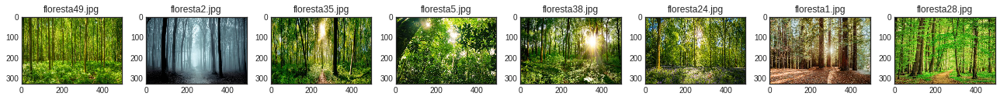

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


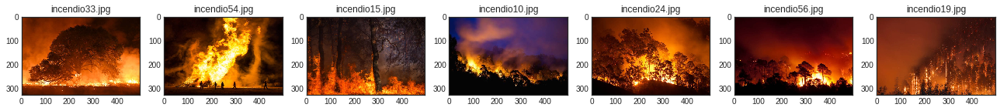

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


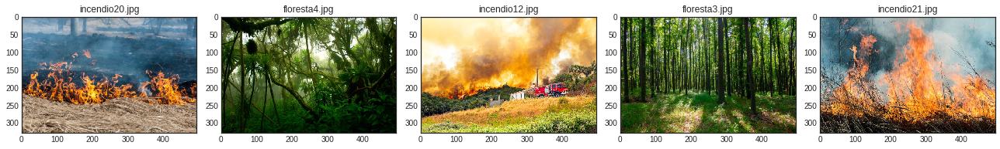

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  1
florestas_agrupadas_corretamente:


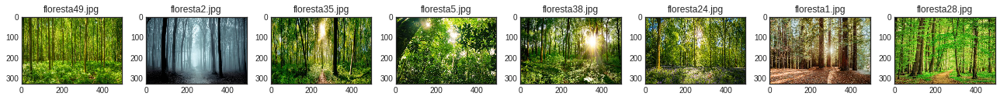

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


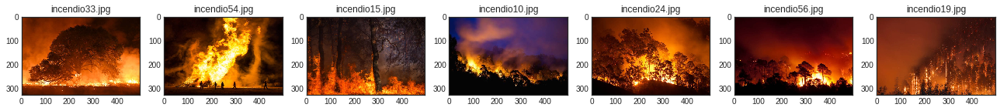

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


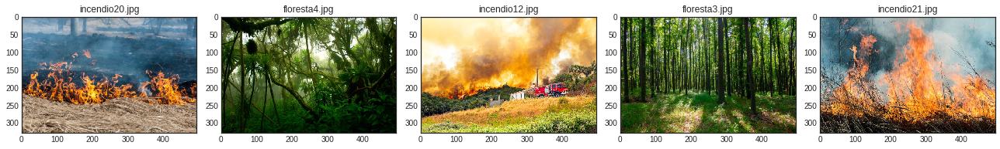

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  2
florestas_agrupadas_corretamente:


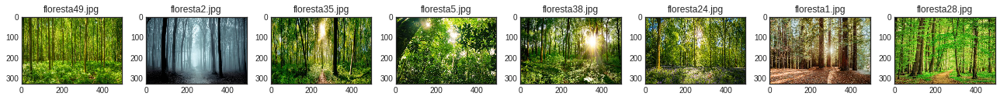

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


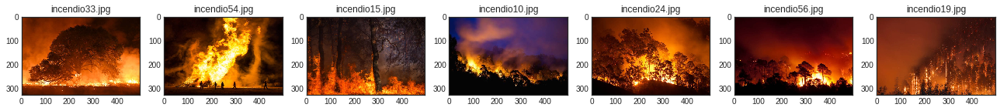

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


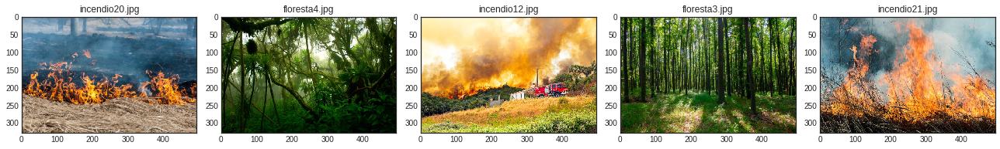

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  3
florestas_agrupadas_corretamente:


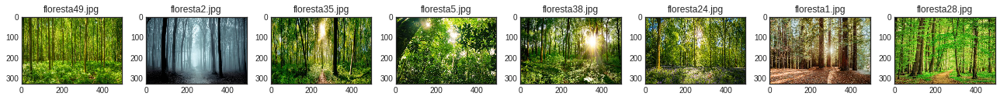

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


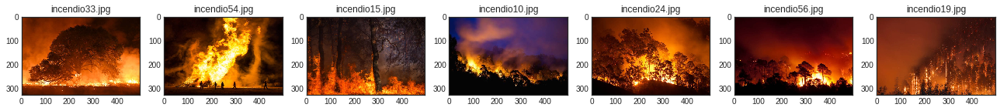

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


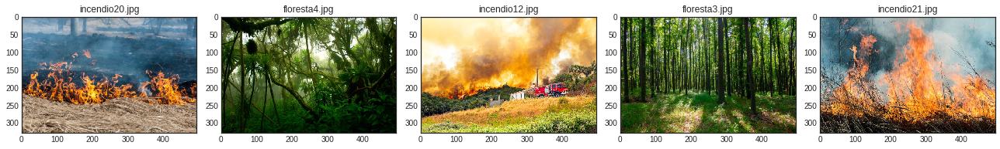

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  4
florestas_agrupadas_corretamente:


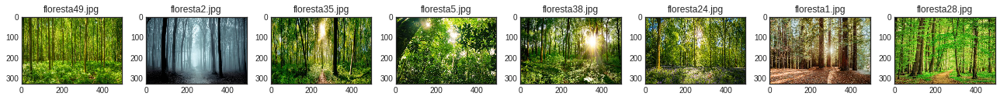

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


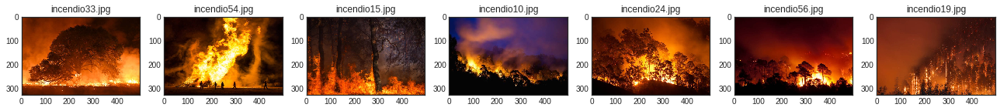

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


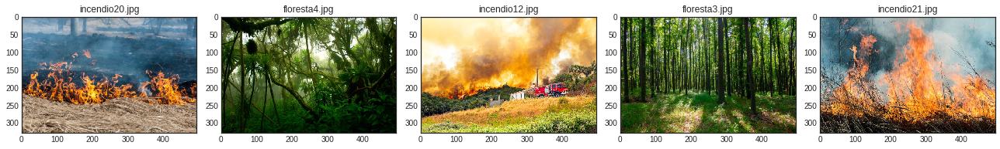

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  5
florestas_agrupadas_corretamente:


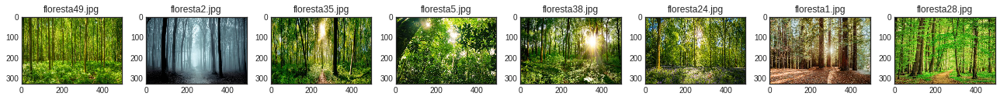

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


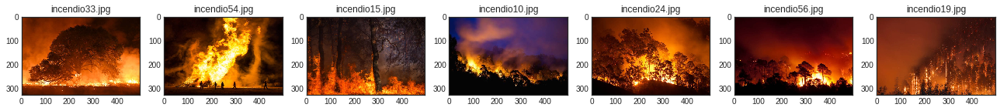

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


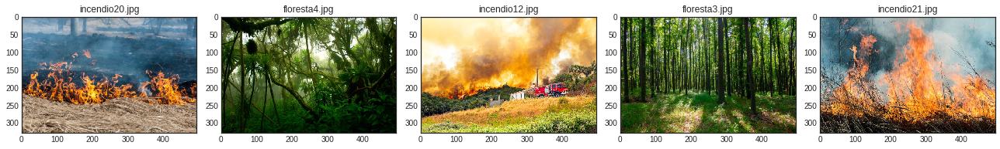

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  6
florestas_agrupadas_corretamente:


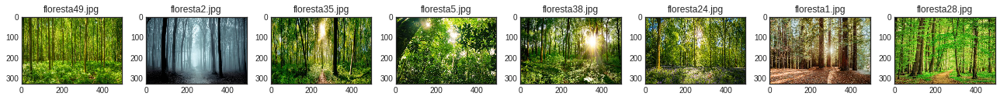

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


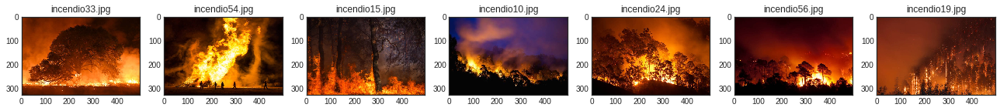

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


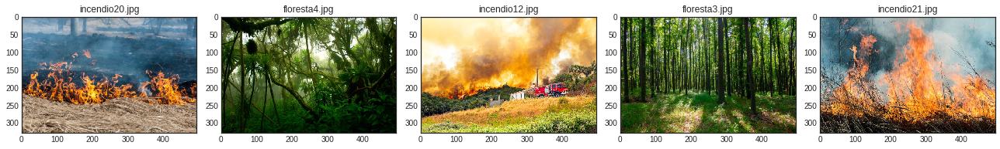

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  7
florestas_agrupadas_corretamente:


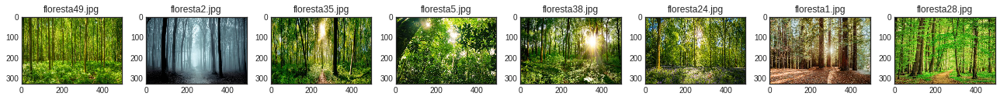

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


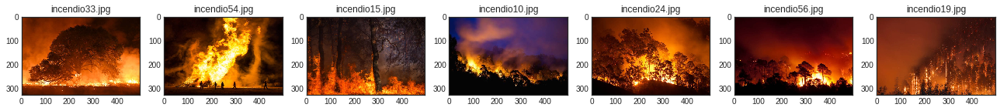

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


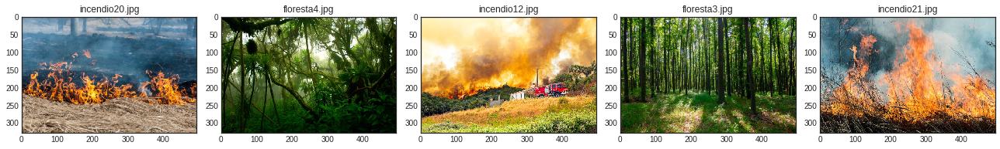

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  8
florestas_agrupadas_corretamente:


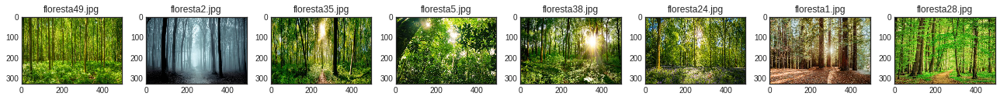

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


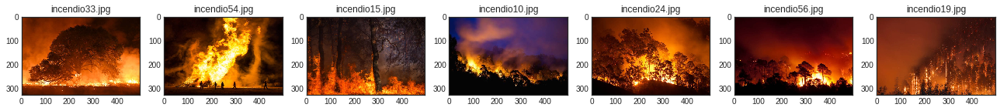

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


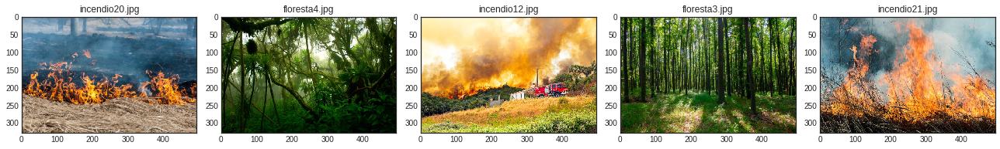

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  9
florestas_agrupadas_corretamente:


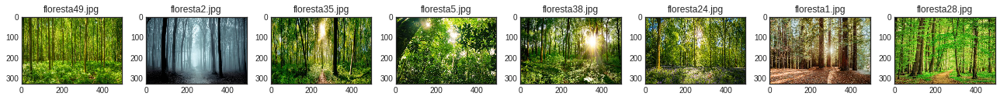

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


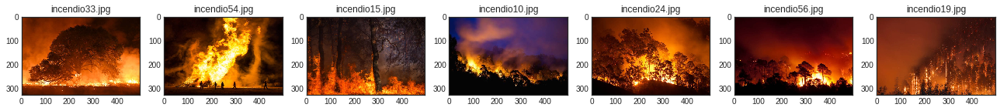

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


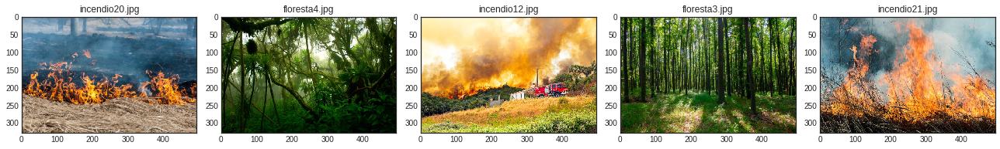

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  10
florestas_agrupadas_corretamente:


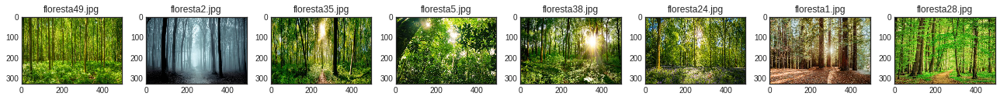

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


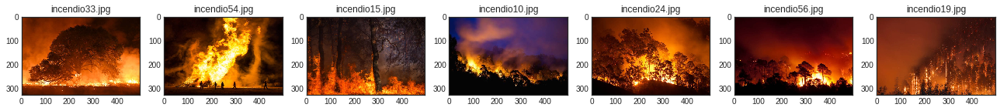

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


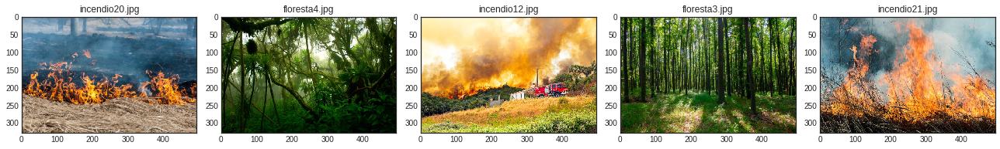

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  11
florestas_agrupadas_corretamente:


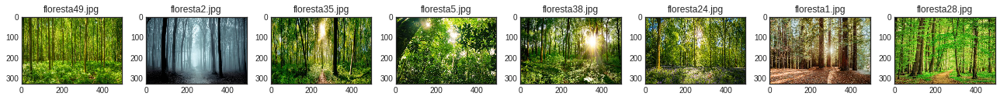

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


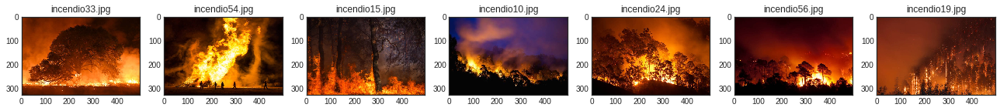

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


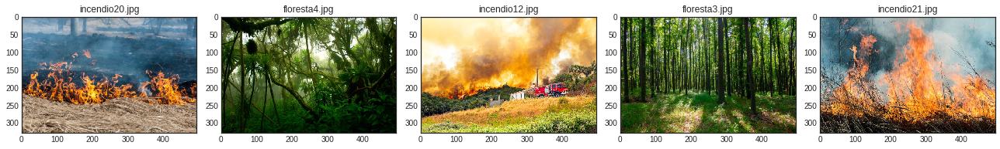

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  12
florestas_agrupadas_corretamente:


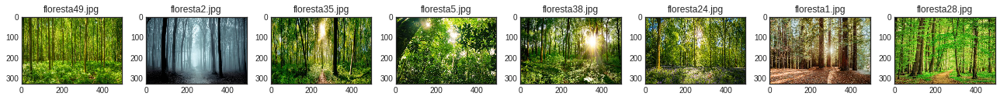

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


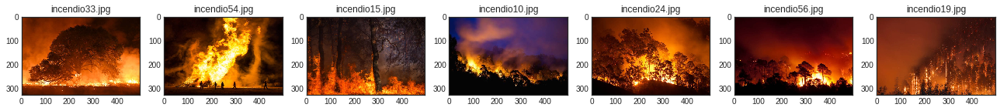

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


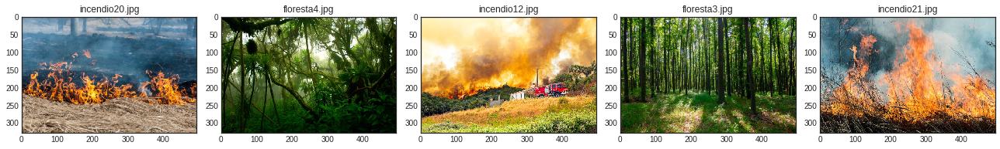

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  13
florestas_agrupadas_corretamente:


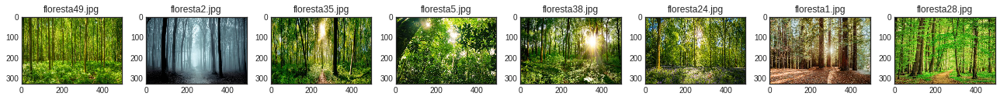

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


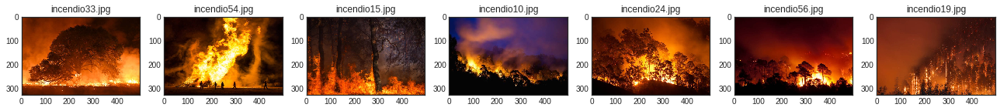

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


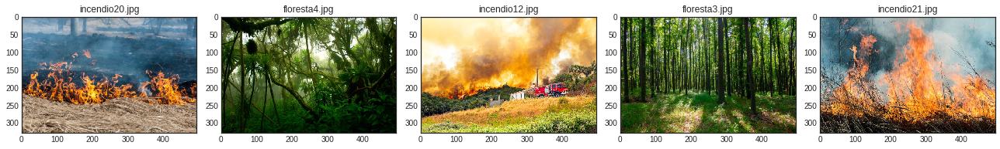

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  14
florestas_agrupadas_corretamente:


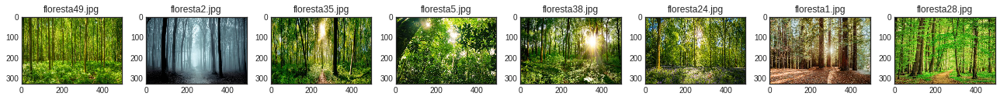

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


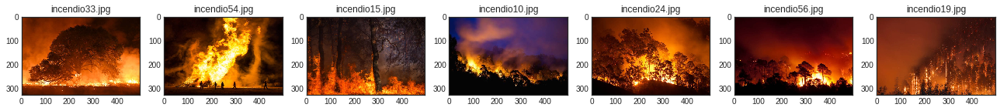

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


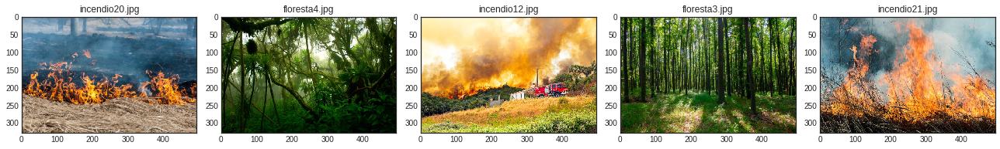

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  15
florestas_agrupadas_corretamente:


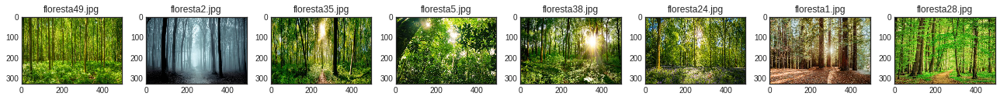

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


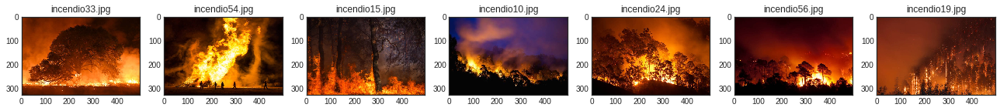

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


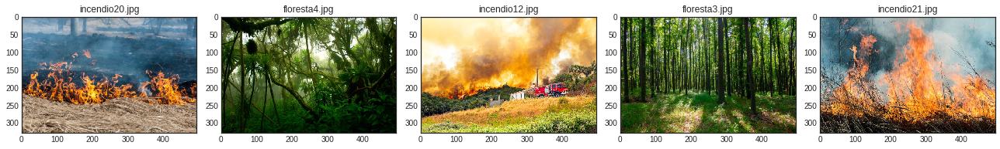

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  16
florestas_agrupadas_corretamente:


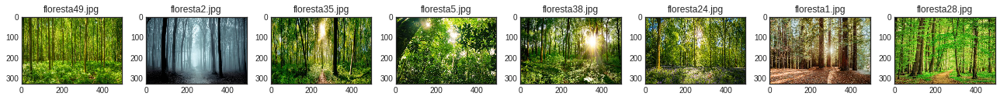

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


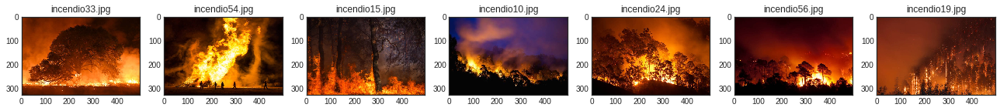

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


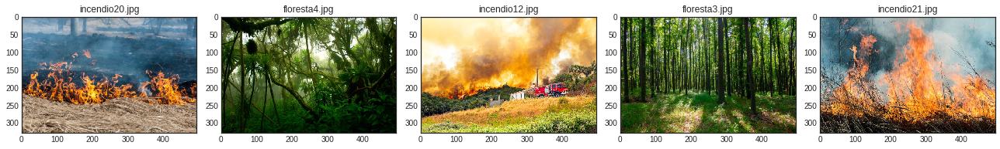

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  17
florestas_agrupadas_corretamente:


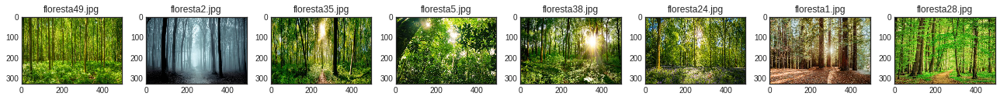

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


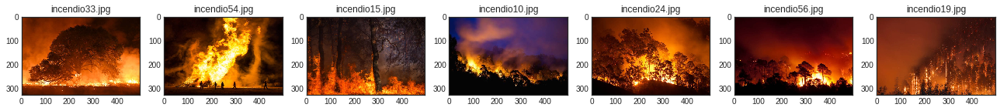

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


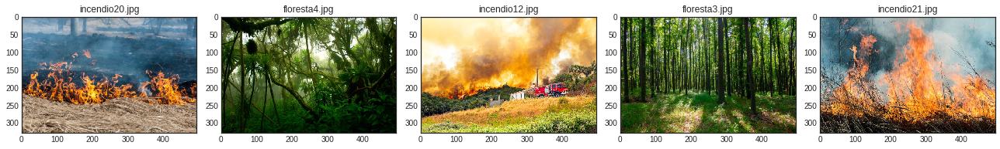

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  18
florestas_agrupadas_corretamente:


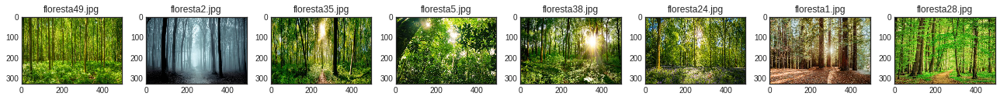

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


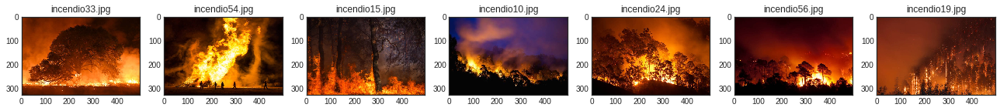

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


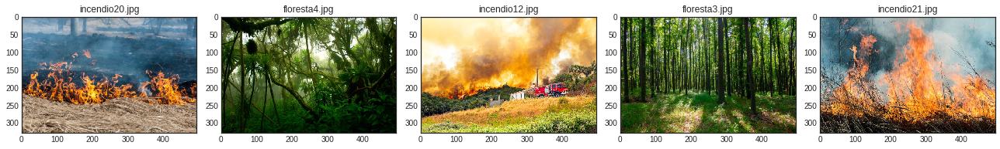

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  19
florestas_agrupadas_corretamente:


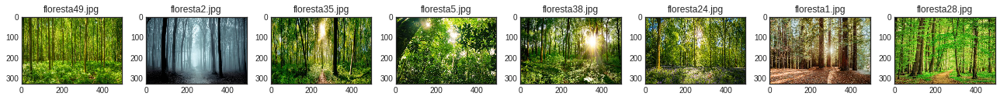

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


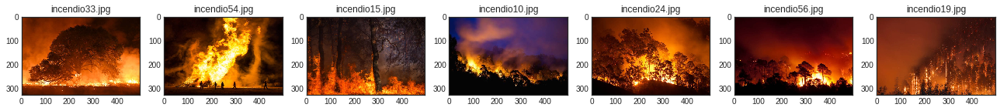

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


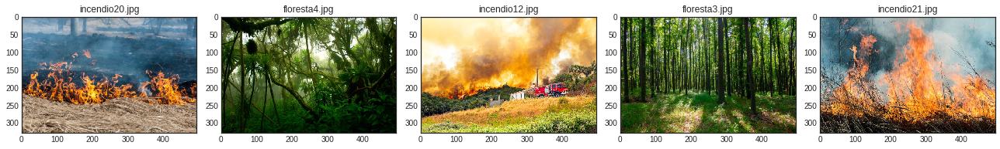

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  20
florestas_agrupadas_corretamente:


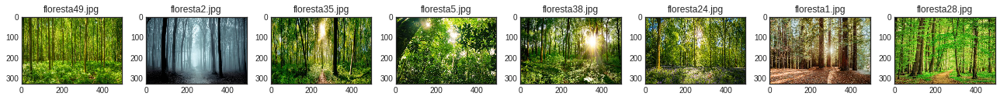

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


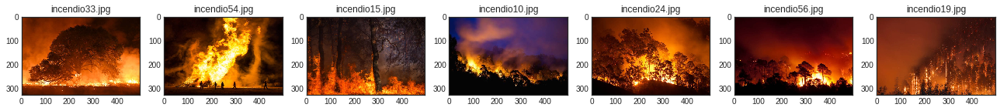

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


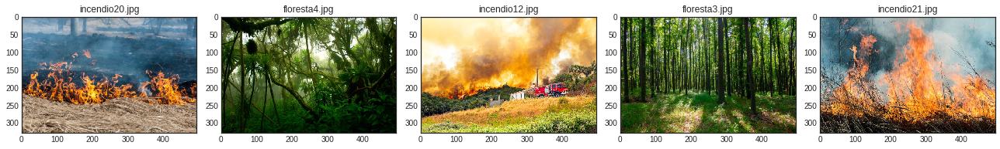

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  21
florestas_agrupadas_corretamente:


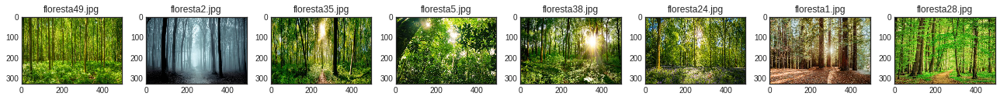

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


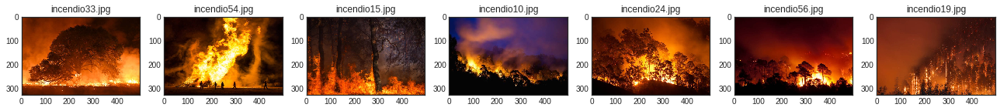

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


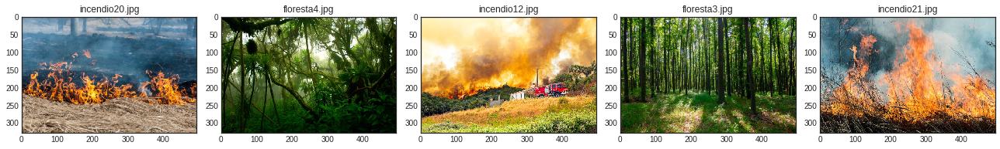

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  22
florestas_agrupadas_corretamente:


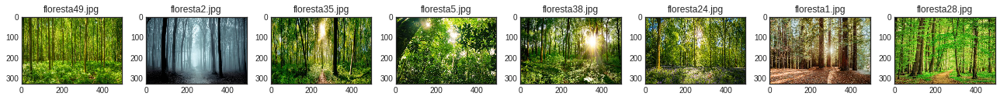

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


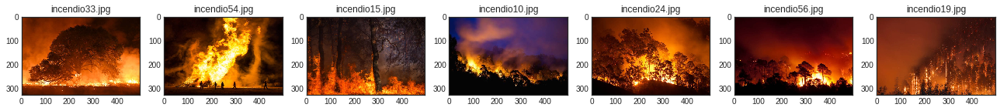

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


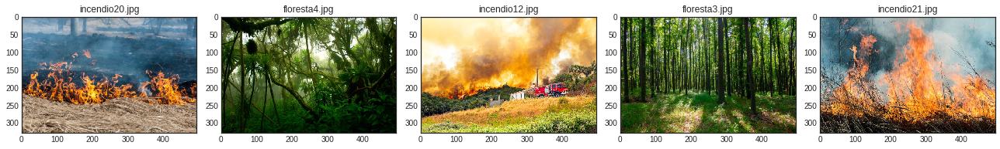

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  23
florestas_agrupadas_corretamente:


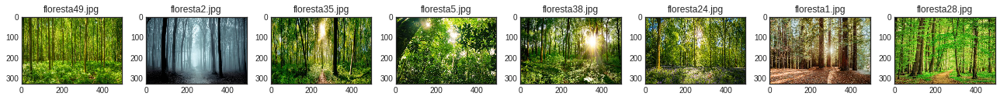

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


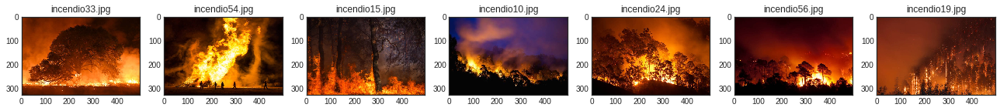

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


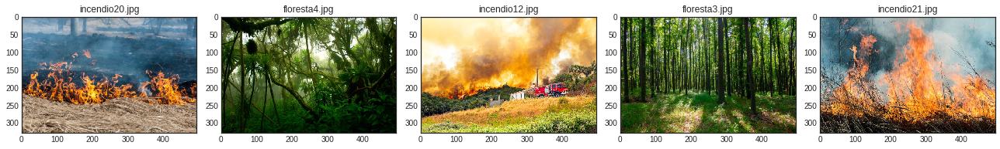

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  24
florestas_agrupadas_corretamente:


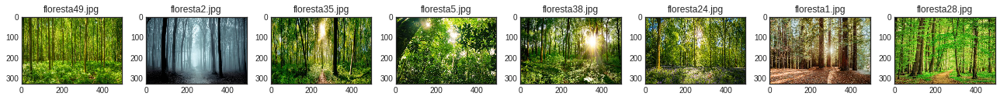

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


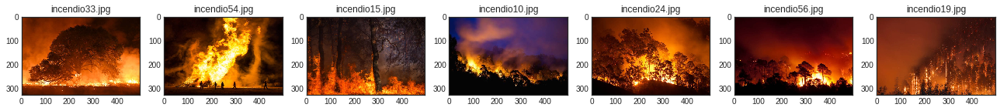

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


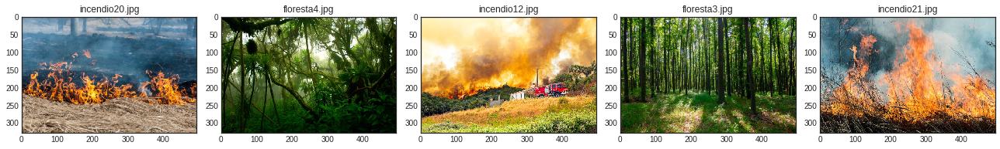

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  25
florestas_agrupadas_corretamente:


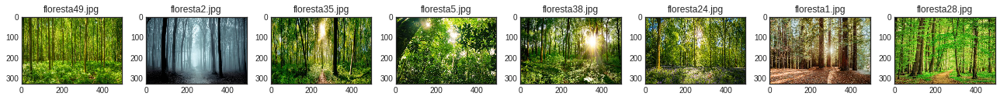

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


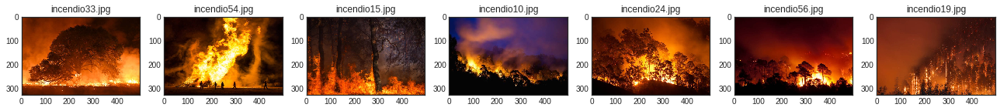

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


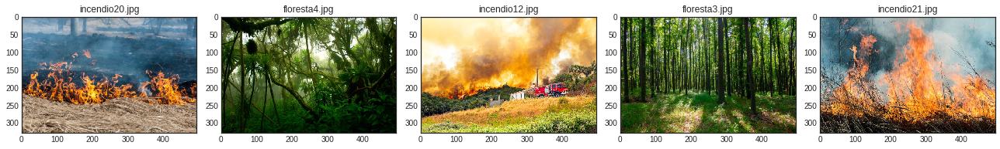

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  26
florestas_agrupadas_corretamente:


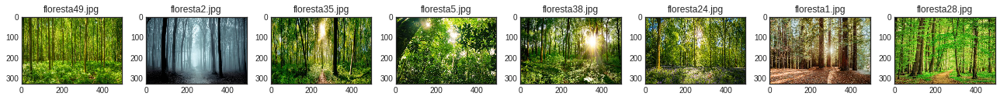

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


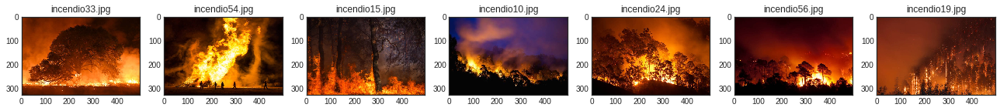

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


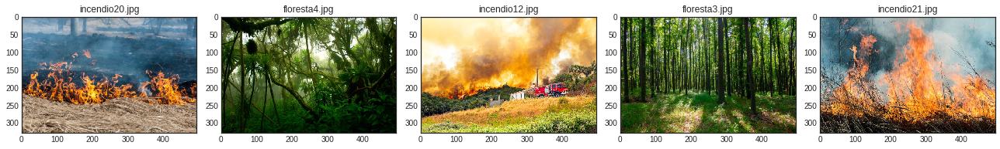

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  27
florestas_agrupadas_corretamente:


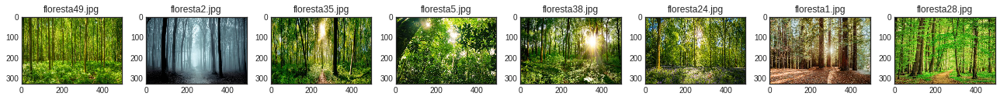

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


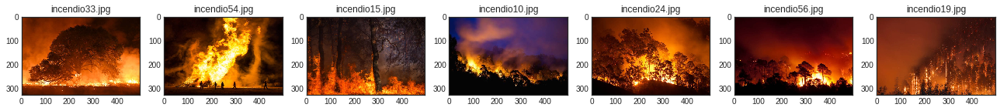

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


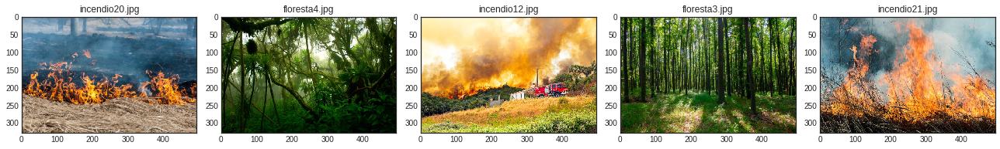

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  28
florestas_agrupadas_corretamente:


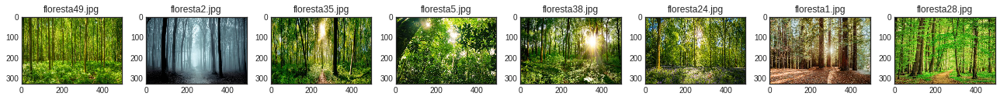

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


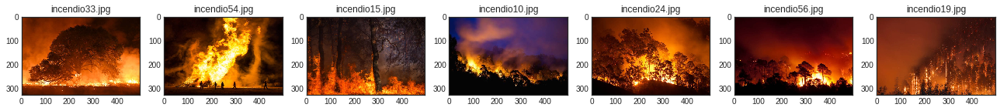

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


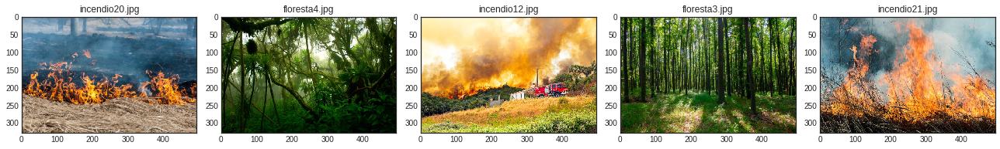

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  29
florestas_agrupadas_corretamente:


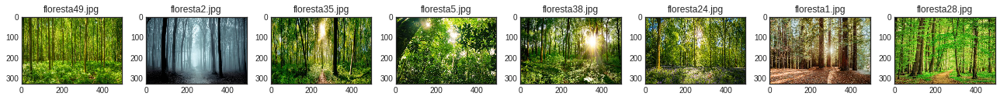

total_florestas_agrupadas_corretamente: 8
######################################################################
incendios_agrupados_corretamente:


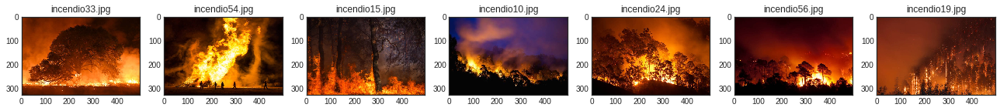

total_incendios_agrupados_corretamente: 7
######################################################################
florestas_e_incendios_agrupados_incorretamente:


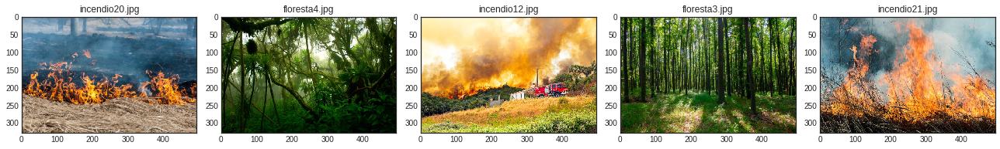

total_florestas_e_incendios_agrupados_incorretamente: 5
Iteração:  30


In [32]:
from sklearn.cluster import KMeans

for iteracao in range(0,30):

    kmeans = KMeans(n_clusters=2, random_state=0).fit( list(df_teste['data']) )

    dados_agrupados = kmeans.labels_
    centroids = kmeans.cluster_centers_
    df_teste['cluster_group'] = dados_agrupados

    florestas = []
    incendios = []
    erros = []
    for i in df_teste.index:
        if (df_teste.iloc[i,2] == 1 and df_teste.iloc[i,4] == 0):
            florestas.append(df_teste.loc[i])
        elif (df_teste.iloc[i,2] == 2 and df_teste.iloc[i,4] == 1):
            incendios.append(df_teste.loc[i])
        else:
            erros.append(df_teste.loc[i])
    #--------------------------------------------------------------------        
    print("florestas_agrupadas_corretamente:")
    fig1, axes1 = plt.subplots(nrows=1, ncols=len(florestas), figsize=(18, 10))
    cont = 0
    for f in florestas:
        #print(df_teste.iloc[f.name,0])
        path = os.path.join('dataset','teste', df_teste.iloc[f.name,0])
        img = skimage.io.imread(path)
        axes1[cont].imshow(img) # mpimg.imread(  ) 
        axes1[cont].set_title(df_teste.iloc[f.name,0])
        cont = cont+1
    fig1.tight_layout()
    plt.show()
    print("total_florestas_agrupadas_corretamente:",len(florestas))
    print(70*"#")
    print("incendios_agrupados_corretamente:")
    fig2, axes2 = plt.subplots(nrows=1, ncols=len(incendios), figsize=(18, 10))
    cont2 = 0
    for i in incendios:
        #print(df_teste.iloc[i.name,0])
        path = os.path.join('dataset','teste', df_teste.iloc[i.name,0])
        img = skimage.io.imread(path)
        axes2[cont2].imshow(img) # mpimg.imread(  ) 
        axes2[cont2].set_title(df_teste.iloc[i.name,0])
        cont2 = cont2+1
    fig2.tight_layout()
    plt.show()
    print("total_incendios_agrupados_corretamente:",len(incendios))
    print(70*"#")
    print("florestas_e_incendios_agrupados_incorretamente:")
    fig3, axes3 = plt.subplots(nrows=1, ncols=len(erros), figsize=(18, 10))
    cont3 = 0
    for e in erros:
        #print(df_teste.iloc[e.name,0])
        path = os.path.join('dataset','teste', df_teste.iloc[e.name,0])
        img = skimage.io.imread(path)
        axes3[cont3].imshow(img) # mpimg.imread(  ) 
        axes3[cont3].set_title(df_teste.iloc[e.name,0])
        cont3 = cont3+1
    fig3.tight_layout()
    plt.show()
    print("total_florestas_e_incendios_agrupados_incorretamente:",len(erros))
    print("Iteração: ",(iteracao+1) )
    new_row = {'iteracao' : iteracao+1, 'floresta' : len(florestas), 'incendio' : len(incendios), 'erro' : len(erros)}
    #append row to the dataframe
    df_results =  df_results.append(new_row, ignore_index=True)
    print(70*"=")

df_results.to_excel('results_30_runs_kmeans_df_teste.xlsx',index=False)
    

### Classification - Classificação de Dados (Aprendizado supervisionado) - Os dados tem um rótulo/classe

In [8]:
# classificação
from sklearn import svm
clf1 = svm.SVC(gamma='scale')
clf1.fit(list(df_treino['data']), list(df_treino['classe']))
y_pred = clf1.predict( list(df_teste['data']) )
df_teste['classe_predita'] = y_pred
# df_teste
print("Matriz de confusão:\n",confusion_matrix( list(df_teste['classe_real']), list(df_teste['classe_predita']) ) )
print("Classification Report:\n",classification_report( list(df_teste['classe_real']), list(df_teste['classe_predita']) ))
print("Accuracy:",accuracy_score(list(df_teste['classe_real']), y_pred))

Matriz de confusão:
 [[7 3]
 [7 3]]
Classification Report:
               precision    recall  f1-score   support

           1       0.50      0.70      0.58        10
           2       0.50      0.30      0.37        10

    accuracy                           0.50        20
   macro avg       0.50      0.50      0.48        20
weighted avg       0.50      0.50      0.48        20

Accuracy: 0.5


In [9]:
from sklearn.naive_bayes import GaussianNB
clf2 = GaussianNB()
clf2.fit(list(df_treino['data']), list(df_treino['classe']))
y_pred = clf2.predict(list(df_teste['data']))
df_teste['classe_predita'] = y_pred
print("Matriz de confusão:\n",confusion_matrix( list(df_teste['classe_real']), list(df_teste['classe_predita']) ) )
print("Classification Report:\n",classification_report( list(df_teste['classe_real']), list(df_teste['classe_predita']) ))
print("Accuracy:",accuracy_score(list(df_teste['classe_real']), y_pred))

Matriz de confusão:
 [[5 5]
 [6 4]]
Classification Report:
               precision    recall  f1-score   support

           1       0.45      0.50      0.48        10
           2       0.44      0.40      0.42        10

    accuracy                           0.45        20
   macro avg       0.45      0.45      0.45        20
weighted avg       0.45      0.45      0.45        20

Accuracy: 0.45


In [10]:
from sklearn.tree import DecisionTreeClassifier
clf3 = DecisionTreeClassifier(random_state=0)
clf3.fit(list(df_treino['data']), list(df_treino['classe']))
y_pred = clf3.predict(list(df_teste['data']))
df_teste['classe_predita'] = y_pred
print("Matriz de confusão:\n",confusion_matrix( list(df_teste['classe_real']), list(df_teste['classe_predita']) ) )
print("Classification Report:\n",classification_report( list(df_teste['classe_real']), list(df_teste['classe_predita']) ))
print("Accuracy:",accuracy_score(list(df_teste['classe_real']), y_pred))

Matriz de confusão:
 [[3 7]
 [3 7]]
Classification Report:
               precision    recall  f1-score   support

           1       0.50      0.30      0.37        10
           2       0.50      0.70      0.58        10

    accuracy                           0.50        20
   macro avg       0.50      0.50      0.48        20
weighted avg       0.50      0.50      0.48        20

Accuracy: 0.5


In [11]:
from sklearn.linear_model import LogisticRegression
clf4 = LogisticRegression(solver='lbfgs', multi_class='multinomial',random_state=1)
clf4.fit(list(df_treino['data']), list(df_treino['classe']))
y_pred = clf4.predict(list(df_teste['data']))
df_teste['classe_predita'] = y_pred
print("Matriz de confusão:\n",confusion_matrix( list(df_teste['classe_real']), list(df_teste['classe_predita']) ) )
print("Classification Report:\n",classification_report( list(df_teste['classe_real']), list(df_teste['classe_predita']) ))
print("Accuracy:",accuracy_score(list(df_teste['classe_real']), y_pred))

Matriz de confusão:
 [[7 3]
 [5 5]]
Classification Report:
               precision    recall  f1-score   support

           1       0.58      0.70      0.64        10
           2       0.62      0.50      0.56        10

    accuracy                           0.60        20
   macro avg       0.60      0.60      0.60        20
weighted avg       0.60      0.60      0.60        20

Accuracy: 0.6


/home/rafael-sanches/Documentos/Doutorado/Disciplinas/Mineracao_de_Dados_Complexos/venv_python3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:947: ConvergenceWarning: lbfgs failed to converge. Increase the number of iterations.
  "of iterations.", ConvergenceWarning)


In [12]:
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
clf5 = RandomForestClassifier(n_estimators=50, random_state=1)
clf5.fit(list(df_treino['data']), list(df_treino['classe']))
y_pred = clf5.predict(list(df_teste['data']))
df_teste['classe_predita'] = y_pred
print("Matriz de confusão:\n",confusion_matrix( list(df_teste['classe_real']), list(df_teste['classe_predita']) ) )
print("Classification Report:\n",classification_report( list(df_teste['classe_real']), list(df_teste['classe_predita']) ))
print("Accuracy:",accuracy_score(list(df_teste['classe_real']), y_pred))

Matriz de confusão:
 [[5 5]
 [5 5]]
Classification Report:
               precision    recall  f1-score   support

           1       0.50      0.50      0.50        10
           2       0.50      0.50      0.50        10

    accuracy                           0.50        20
   macro avg       0.50      0.50      0.50        20
weighted avg       0.50      0.50      0.50        20

Accuracy: 0.5


In [13]:
eclf1 = VotingClassifier(estimators=[('svm', clf1), ('nb', clf2), ('dt', clf3),('lr', clf4), ('rf', clf5)], voting='hard')
eclf1 = eclf1.fit(list(df_treino['data']), list(df_treino['classe']))
y_pred = eclf1.predict(list(df_teste['data']))
df_teste['classe_predita'] = y_pred
print("Matriz de confusão:\n",confusion_matrix( list(df_teste['classe_real']), list(df_teste['classe_predita']) ) )
print("Classification Report:\n",classification_report( list(df_teste['classe_real']), list(df_teste['classe_predita']) ))
print("Accuracy:",accuracy_score(list(df_teste['classe_real']), y_pred))

/home/rafael-sanches/Documentos/Doutorado/Disciplinas/Mineracao_de_Dados_Complexos/venv_python3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:947: ConvergenceWarning: lbfgs failed to converge. Increase the number of iterations.
  "of iterations.", ConvergenceWarning)


Matriz de confusão:
 [[7 3]
 [6 4]]
Classification Report:
               precision    recall  f1-score   support

           1       0.54      0.70      0.61        10
           2       0.57      0.40      0.47        10

    accuracy                           0.55        20
   macro avg       0.55      0.55      0.54        20
weighted avg       0.55      0.55      0.54        20

Accuracy: 0.55


In [14]:
from sklearn.ensemble import AdaBoostClassifier
clf6 = AdaBoostClassifier(n_estimators=100, random_state=0)
# clf6.feature_importances_  
clf6.fit(list(df_treino['data']), list(df_treino['classe']))
y_pred = clf6.predict(list(df_teste['data']))
df_teste['classe_predita'] = y_pred
print("Matriz de confusão:\n",confusion_matrix( list(df_teste['classe_real']), list(df_teste['classe_predita']) ) )
print("Classification Report:\n",classification_report( list(df_teste['classe_real']), list(df_teste['classe_predita']) ))
print("Accuracy:",accuracy_score(list(df_teste['classe_real']), y_pred))

Matriz de confusão:
 [[7 3]
 [4 6]]
Classification Report:
               precision    recall  f1-score   support

           1       0.64      0.70      0.67        10
           2       0.67      0.60      0.63        10

    accuracy                           0.65        20
   macro avg       0.65      0.65      0.65        20
weighted avg       0.65      0.65      0.65        20

Accuracy: 0.65


In [15]:
from sklearn.neural_network import MLPClassifier
clf7 = MLPClassifier(hidden_layer_sizes=(2, ), activation='relu', solver='adam', alpha=0.0001, batch_size='auto', learning_rate='constant', learning_rate_init=0.001, power_t=0.5, max_iter=200, shuffle=True, random_state=None, tol=0.0001, verbose=False, warm_start=False, momentum=0.9, nesterovs_momentum=True, early_stopping=False, validation_fraction=0.1, beta_1=0.9, beta_2=0.999, epsilon=1e-08, n_iter_no_change=10)
clf7.fit(list(df_treino['data']), list(df_treino['classe']))
y_pred = clf7.predict(list(df_teste['data']))
df_teste['classe_predita'] = y_pred
print("Matriz de confusão:\n",confusion_matrix( list(df_teste['classe_real']), list(df_teste['classe_predita']) ) )
print("Classification Report:\n",classification_report( list(df_teste['classe_real']), list(df_teste['classe_predita']) ))
print("Accuracy:",accuracy_score(list(df_teste['classe_real']), y_pred))

Matriz de confusão:
 [[ 0 10]
 [ 0 10]]
Classification Report:
               precision    recall  f1-score   support

           1       0.00      0.00      0.00        10
           2       0.50      1.00      0.67        10

    accuracy                           0.50        20
   macro avg       0.25      0.50      0.33        20
weighted avg       0.25      0.50      0.33        20

Accuracy: 0.5


/home/rafael-sanches/Documentos/Doutorado/Disciplinas/Mineracao_de_Dados_Complexos/venv_python3/lib/python3.6/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


In [16]:
'''
# df_teste[ df_teste['classe_real'] !=  df_teste['classe_predita']]
from __future__ import absolute_import, division, print_function, unicode_literals

# TensorFlow e tf.keras
import tensorflow as tf
from tensorflow import keras

print(tf.__version__)

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
'''

"\n# df_teste[ df_teste['classe_real'] !=  df_teste['classe_predita']]\nfrom __future__ import absolute_import, division, print_function, unicode_literals\n\n# TensorFlow e tf.keras\nimport tensorflow as tf\nfrom tensorflow import keras\n\nprint(tf.__version__)\n\nfrom tensorflow.keras.models import Sequential\nfrom tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D\nfrom tensorflow.keras.preprocessing.image import ImageDataGenerator\n"

In [17]:
'''
PATH = 'datasetcnn'
train_dir = os.path.join(PATH, 'treino')
validation_dir = os.path.join(PATH, 'teste')

train_floresta_dir = os.path.join(train_dir, 'floresta')  # directory with our training cat pictures
train_incendio_dir = os.path.join(train_dir, 'incendio')  # directory with our training dog pictures
validation_floresta_dir = os.path.join(validation_dir, 'floresta')  # directory with our validation cat pictures
validation_incendio_dir = os.path.join(validation_dir, 'incendio')  # directory with our validation dog pictures

num_floresta_tr = len(os.listdir(train_floresta_dir))
num_incendio_tr = len(os.listdir(train_incendio_dir))

num_floresta_val = len(os.listdir(validation_floresta_dir))
num_incendio_val = len(os.listdir(validation_incendio_dir))

total_train = num_floresta_tr + num_incendio_tr
total_val = num_floresta_val + num_incendio_val

print('total training floresta images:', num_floresta_tr)
print('total training incendio images:', num_incendio_tr)

print('total validation floresta images:', num_floresta_val)
print('total validation incendio images:', num_incendio_val)
print("--")
print("Total training images:", total_train)
print("Total validation images:", total_val)


batch_size = 128
epochs = 15
IMG_HEIGHT = 512#150
IMG_WIDTH = 512#150

train_image_generator = ImageDataGenerator(rescale=1./255) # Generator for our training data
validation_image_generator = ImageDataGenerator(rescale=1./255) # Generator for our validation data

train_data_gen = train_image_generator.flow_from_directory(batch_size=batch_size,
                                                           directory=train_dir,
                                                           shuffle=True,
                                                           target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                           class_mode='binary')

val_data_gen = validation_image_generator.flow_from_directory(batch_size=batch_size,
                                                              directory=validation_dir,
                                                              target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                              class_mode='binary')

x_train, y_train = next(train_data_gen)

x_test, y_test = next(val_data_gen)

# This function will plot images in the form of a grid with 1 row and 5 columns where images are placed in each column.
def plotImages(images_arr):
    fig, axes = plt.subplots(1, 5, figsize=(20,20))
    axes = axes.flatten()
    for img, ax in zip( images_arr, axes):
        ax.imshow(img)
        ax.axis('off')
    plt.tight_layout()
    plt.show()

#plotImages(x_train[:5])

model = Sequential([
    Conv2D(16, 3, padding='same', activation='relu', input_shape=(IMG_HEIGHT, IMG_WIDTH ,3)),
    MaxPooling2D(),
    Conv2D(32, 3, padding='same', activation='relu'),
    MaxPooling2D(),
    Conv2D(64, 3, padding='same', activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(512, activation='relu'),
    Dense(1, activation='sigmoid')
])

model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

model.summary()


history = model.fit_generator(
    train_data_gen,
    steps_per_epoch=total_train // batch_size,
    epochs=4,
    validation_data=val_data_gen,
    validation_steps=total_val // batch_size
)

# usage in model
#model.fit(ds_train, epochs=10, verbose=True)

'''
'''
history = model.fit_generator(
    x_train,
    steps_per_epoch=total_train, 
    epochs=4, 
    validation_data=y_train,
    validation_steps=total_val
)
model.fit(train_data_gen, epochs=10, steps_per_epoch=118, validation_data=val_data_gen,validation_steps=(total_val/batch_size)
'''

'\nhistory = model.fit_generator(\n    x_train,\n    steps_per_epoch=total_train, \n    epochs=4, \n    validation_data=y_train,\n    validation_steps=total_val\n)\nmodel.fit(train_data_gen, epochs=10, steps_per_epoch=118, validation_data=val_data_gen,validation_steps=(total_val/batch_size)\n'